In [1]:
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
filtered_data = pd.read_csv("filtered_data/filtered_cell_data.csv")

subset_cells = filtered_data['Cell_ID'].unique()[:5]
subset_data = filtered_data[filtered_data['Cell_ID'].isin(subset_cells)].copy()

birth_times = subset_data.groupby('Cell_ID')['time_minutes'].min()
subset_data.loc[:, 'aligned_time'] = subset_data['time_minutes'] - subset_data['Cell_ID'].map(birth_times)

In [3]:
def calculate_division_time(row):
    if row['division_frame_i'] != -1: 
        birth_time = birth_times[row['Cell_ID']]
        division_time = subset_data.loc[subset_data['frame_i'] == row['division_frame_i'], 'time_minutes']
        if not division_time.empty:
            return division_time.values[0] - birth_time
    return None

subset_data['division_time'] = subset_data.apply(calculate_division_time, axis=1)

In [4]:
columns_to_plot = [
    'bf_mean', 
    'bf_median', 
    'bf_max', 
    'bf_min', 
    'bf_CV', 
    'cell_area_um2', 
    'cell_vol_vox', 
    'major_axis_length', 
    'minor_axis_length', 
    'equivalent_diameter', 
    'solidity', 
    'extent', 
    'velocity_pixel', 
    'velocity_um', 
    'x_centroid', 
    'y_centroid', 
    'moments', 
    'inertia_tensor'
]

C:\Users\Aarush\AppData\Local\Temp\ipykernel_13620\434677736.py:17: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


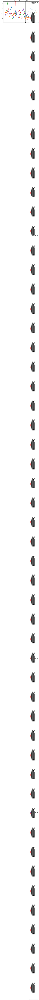

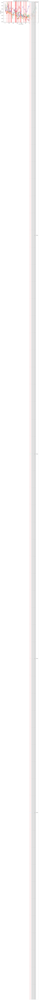

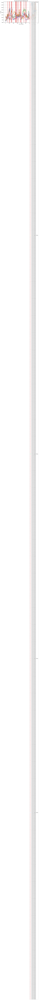

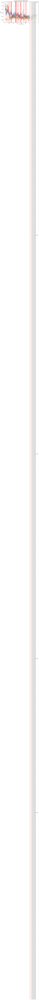

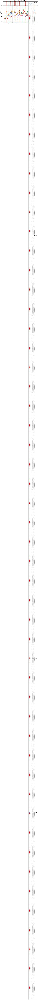

...

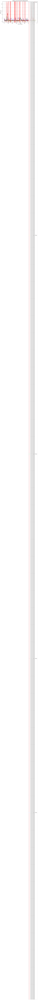

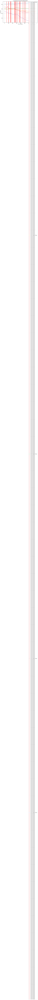

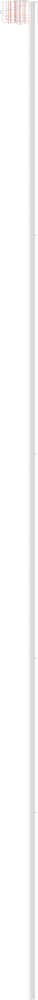

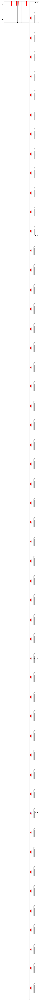

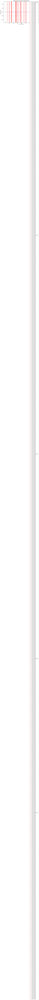

In [5]:
for column in columns_to_plot:
    plt.figure(figsize=(10, 6))
    
    for cell_id, group in subset_data.groupby('Cell_ID'):
        plt.plot(group['aligned_time'], group[column], label=f'Cell {cell_id} (Aligned Time)')
        
        division_time = group['division_time'].dropna()
        if not division_time.empty:
            for time in division_time:
                plt.axvline(x=time, color='red', linestyle='--', label=f'Cell {cell_id} Division')

    plt.xlabel("Time (minutes)")
    plt.ylabel(column)
    plt.title(f"{column} over Time for Selected Cells")
    plt.legend(loc='upper right')
    plt.grid()
    plt.tight_layout()
    plt.show()